# Deep Convolutional Generative Adversarial Network

## What are GANs?
[Generative Adversarial Networks](https://arxiv.org/abs/1406.2661) (GANs) are one of the most interesting ideas in computer science today. Two models are trained simultaneously by an adversarial process. A *generator* ("the artist") learns to create images that look real, while a *discriminator* ("the art critic") learns to tell real images apart from fakes.

![A diagram of a generator and discriminator](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/gan1.png?raw=1)

During training, the *generator* progressively becomes better at creating images that look real, while the *discriminator* becomes better at telling them apart. The process reaches equilibrium when the *discriminator* can no longer distinguish real images from fakes.

![A second diagram of a generator and discriminator](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/gan2.png?raw=1)



| Role          | Component                                                         | Goal                                    |
| ------------- | ----------------------------------------------------------------- | --------------------------------------- |
| Genie         | Generator (CNN with transpose conv layers)                        | Create fake images from noise           |
| Disco         | Discriminator (CNN)                                               | Classify images as real (1) or fake (0) |
| Game          | Minimax optimization                                              | $\min_G \max_D V(D,G)$                  |
| Win condition | Generator creates images that fool the discriminator consistently |                                         |

### Setup

In [ ]:
# To generate GIFs
!pip install imageio
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-5gl2jyvs
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/docs /tmp/pip-req-build-5gl2jyvs
  Resolved https://github.com/tensorflow/docs to commit a85e05593b485171c388df1a45b6da668edc39e7
  Preparing metadata (setup.py) ... done
  Created wheel for tensorflow-docs: filename=tensorflow_docs-2025.3.6.10029-py3-none-any.whl size=186351 sha256=3e84bb0decdb192a3f3dc77641fca36eb4f26c9b68b45c9435cdc9190674547d
  Stored in directory: /tmp/pip-ephem-wheel-cache-phm533oj/wheels/34/53/89/3db54cf97ce0f0261aaab3fdc12a847ea0879d34edf373e2c5
Successfully built tensorflow-docs


In [ ]:
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import cv2 as cv
import tensorflow as tf
from tensorflow.keras import layers
import time
from google.colab.patches import cv2_imshow
from IPython import display
from tensorflow.keras.layers import Conv2D, BatchNormalization, LeakyReLU, Flatten, Dropout, Dense, Conv2DTranspose, Reshape
from tensorflow.keras.models import Sequential

### Load and prepare the dataset

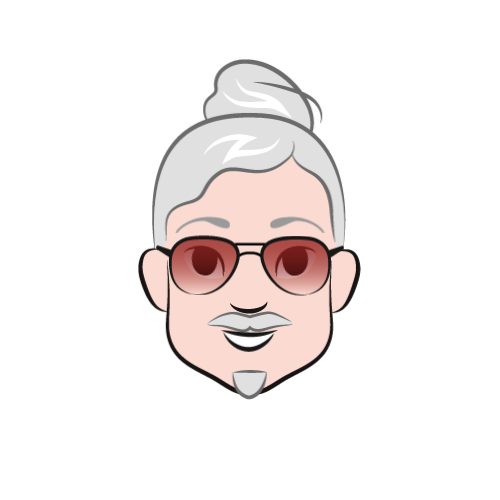

(500, 500, 3)


In [ ]:
image = cv.imread('/kaggle/input/cartoonset10k/cartoonset10k/cs10000053986926948907.png')
cv2_imshow(image)
print(image.shape)

In [ ]:
subset_size = 200
IMG_SIZE = 256
BATCH_SIZE = 1

# Load entire dataset first
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    '/kaggle/input/cartoonset10k/cartoonset10k',
    label_mode=None,
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE,
    shuffle=True
)

# Normalize to [-1, 1]
dataset = dataset.map(lambda x: (x / 127.5) - 1.0)

# Limit to ~1000 images worth of batches
batches_to_take = subset_size // BATCH_SIZE  # = 15 if BATCH_SIZE=64
dataset = dataset.take(batches_to_take)

Found 10000 files.


## Create the models

Both the generator and discriminator are defined using the [Keras Sequential API](https://www.tensorflow.org/guide/keras#sequential_model).

### The Generator

The generator uses `tf.keras.layers.Conv2DTranspose` (upsampling) layers to produce an image from a seed (random noise). Start with a `Dense` layer that takes this seed as input, then upsample several times until you reach the desired image size of 256x256x3. Notice the `tf.keras.layers.LeakyReLU` activation for each layer, except the output layer which uses tanh.

In [ ]:
def make_generator_model():
    model = Sequential(name="Generator")

    # Hidden Layer 1: Start with 16 x 16 image
    n_nodes = 16 * 16 * 512 # number of nodes in the first hidden layer
    model.add(Dense(n_nodes, input_shape=(100,), name='Generator-Hidden-Layer-1'))
    model.add(Reshape((16, 16, 512), name='Generator-Hidden-Layer-Reshape-1'))

    # Hidden Layer 2: Upsample to 32 x 32
    model.add(Conv2DTranspose(filters=256, kernel_size=(3, 3), strides=(2, 2), padding='same', name='Generator-Hidden-Layer-2'))
    model.add(LeakyReLU(alpha=0.2))

    # Hidden Layer 3: Upsample to 64 x 64
    model.add(Conv2DTranspose(filters=128, kernel_size=(3, 3), strides=(2, 2), padding='same', name='Generator-Hidden-Layer-3'))
    model.add(LeakyReLU(alpha=0.2))

    # Hidden Layer 4: Upsample to 128 x 128
    model.add(Conv2DTranspose(filters=64, kernel_size=(3, 3), strides=(2, 2), padding='same', name='Generator-Hidden-Layer-4'))
    model.add(LeakyReLU(alpha=0.2))

    # Hidden Layer 5: Upsample to 256 x 256
    model.add(Conv2DTranspose(filters=32, kernel_size=(3, 3), strides=(2, 2), padding='same', name='Generator-Hidden-Layer-5'))
    model.add(LeakyReLU(alpha=0.2))

    # Output Layer: we use 3 filters because we have 3 channels for a color image.
    model.add(Conv2DTranspose(3, kernel_size=(3, 3), activation='tanh', strides=(1, 1), padding='same', name='Generator-Output-Layer'))

    return model

Use the (as yet untrained) generator to create an image.

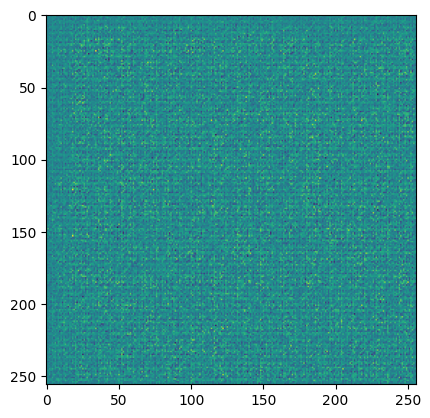

In [ ]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0])

### The Discriminator

The discriminator is a CNN-based image classifier.

In [ ]:
def make_discriminator_model():
    model = Sequential(name="Discriminator")

    # Input: 256x256x3
    model.add(Conv2D(32, (3, 3), strides=(2, 2), padding='same', input_shape=(256, 256, 3), name='Disc-Conv-1'))
    model.add(LeakyReLU(alpha=0.2))

    # 128x128x32
    model.add(Conv2D(64, (3, 3), strides=(2, 2), padding='same', name='Disc-Conv-2'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))

    # 64x64x64
    model.add(Conv2D(128, (3, 3), strides=(2, 2), padding='same', name='Disc-Conv-3'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))

    # 32x32x128
    model.add(Conv2D(256, (3, 3), strides=(2, 2), padding='same', name='Disc-Conv-4'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))

    # 16x16x256
    model.add(Conv2D(512, (3, 3), strides=(2, 2), padding='same', name='Disc-Conv-5'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))

    # 8x8x512
    model.add(Conv2D(512, (3, 3), strides=(2, 2), padding='same', name='Disc-Conv-6'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))

    # 4x4x512
    model.add(Flatten())
    model.add(Dropout(0.3))
    model.add(Dense(1, activation='sigmoid', name='Disc-Output'))

    return model


Use the (as yet untrained) discriminator to classify the generated images as real or fake. The model will be trained to output positive values for real images, and negative values for fake images.

**The sigmoid activation function** produces output values in the range:
More precisely:
The output never actually reaches 0 or 1, but it asymptotically approaches them.

For large negative inputs, the sigmoid output gets very close to 0.

For large positive inputs, the sigmoid output gets very close to 1.

At input = 0, the output is exactly 0.5.

In [ ]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[0.5000043]], shape=(1, 1), dtype=float32)


## Define the loss and optimizers

Define loss functions and optimizers for both models.


In [ ]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

### Discriminator loss

This method quantifies how well the discriminator is able to distinguish real images from fakes. It compares the discriminator's predictions on real images to an array of 1s, and the discriminator's predictions on fake (generated) images to an array of 0s.

In [ ]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

### Generator loss
The generator's loss quantifies how well it was able to trick the discriminator. Intuitively, if the generator is performing well, the discriminator will classify the fake images as real (or 1). Here, compare the discriminators decisions on the generated images to an array of 1s.

In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

The discriminator and the generator optimizers are different since you will train two networks separately.

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

### Save checkpoints
This notebook also demonstrates how to save and restore models, which can be helpful in case a long running training task is interrupted.

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## Define the training loop


In [ ]:
EPOCHS = 400
noise_dim = 100
num_examples_to_generate = 8

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

The training loop begins with generator receiving a random seed as input. That seed is used to produce an image. The discriminator is then used to classify real images (drawn from the training set) and fakes images (produced by the generator). The loss is calculated for each of these models, and the gradients are used to update the generator and discriminator.

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [ ]:
def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      train_step(image_batch)

    # Produce images for the GIF as you go
    display.clear_output(wait=True)
    generate_and_save_images(generator,
                             epoch + 1,
                             seed)

    # Save the model every 15 epochs
    if (epoch + 1) % 15 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator,
                           epochs,
                           seed)

**Generate and save images**


In [ ]:
def generate_and_save_images(model, epoch, test_input):
    # Generate predictions (inference mode)
    predictions = model(test_input, training=False)

    # Create a 2x4 grid (8 images)
    fig = plt.figure(figsize=(8, 6))

    for i in range(8):  # Make sure there are at least 8 images
        plt.subplot(2, 4, i + 1)

        # Convert prediction to numpy and clip values to [0, 1]
        img = predictions[i].numpy()
        img = np.clip(img, 0, 1)

        # Display RGB image
        plt.imshow(img)
        plt.axis('off')

    # Save and show the plot
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()
    plt.close(fig)


## Train the model
Call the `train()` method defined above to train the generator and discriminator simultaneously. Note, training GANs can be tricky. It's important that the generator and discriminator do not overpower each other (e.g., that they train at a similar rate).

At the beginning of the training, the generated images look like random noise. As training progresses, the generated digits will look increasingly real. After about 400 epochs, they resemble Cartoon Faces. This may take about one minute / epoch with the default settings on Colab.

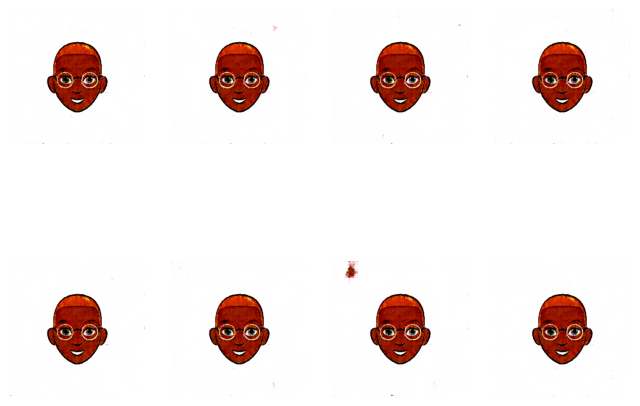

In [ ]:
train(dataset, EPOCHS)

Restore the latest checkpoint.

In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

## Create a GIF


In [ ]:
# Display a single image using the epoch number
def display_image(epoch_no):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

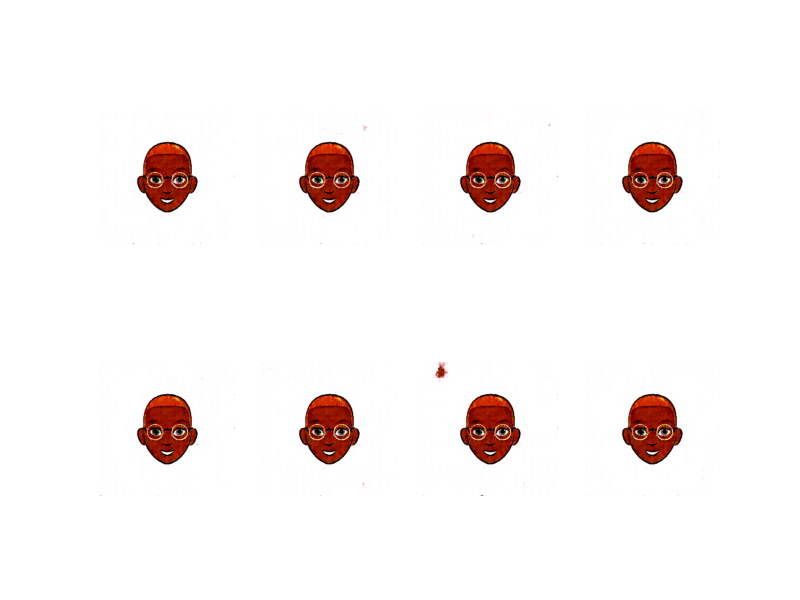

In [ ]:
display_image(EPOCHS)

Use `imageio` to create an animated gif using the images saved during training.

In [ ]:
anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

<ipython-input-54-56bb6d34be2e>:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
<ipython-input-54-56bb6d34be2e>:9: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



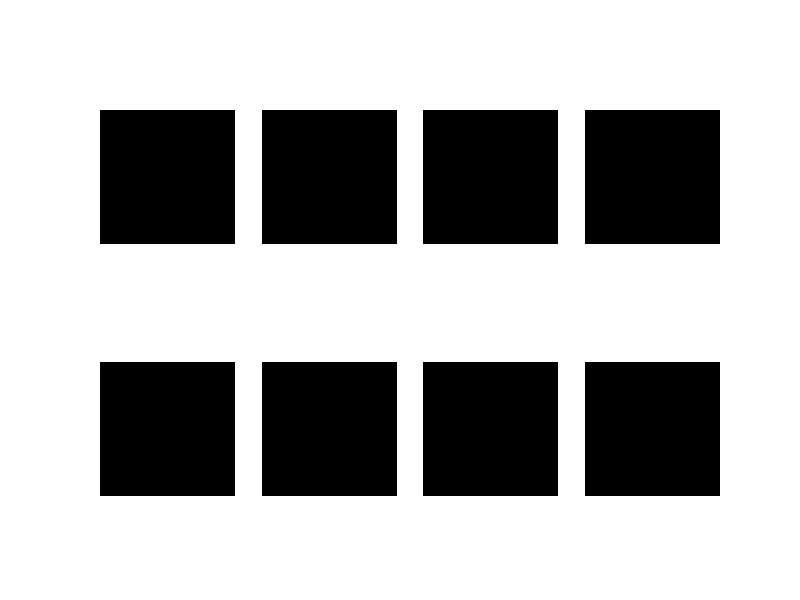

In [ ]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

In [ ]:
# prompt: download anim_file

from google.colab import files
files.download(anim_file)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>